#Section 5: Transfer Learning

##Transfer learning for Intel Image classification

In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics import classification_report, confusion_matrix

#Neural Network packages

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset
from torchvision import models
from torch.optim.lr_scheduler import ExponentialLR
from torch.utils.data.sampler import SubsetRandomSampler
from tqdm import tqdm
import torch.nn.functional as F

seed = torch.manual_seed(0)

import warnings
warnings.filterwarnings('ignore')

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# see what folders are in path
!ls "/content/drive/MyDrive/AI-Internship/IntelImage"

seg_pred  seg_test  seg_train


In [4]:
import os
print(len(os.listdir('/content/drive/MyDrive/AI-Internship/IntelImage/seg_pred/seg_pred'))) # number of pictures in pics
print(len(os.listdir('/content/drive/MyDrive/AI-Internship/IntelImage/seg_train/seg_train'))) # number of pictures in pics
print(len(os.listdir('/content/drive/MyDrive/AI-Internship/IntelImage/seg_test/seg_test'))) # number of pictures in pics

7301
6
6


In [5]:
#Check the size of input images
im = Image.open('/content/drive/MyDrive/AI-Internship/IntelImage/seg_train/seg_train/buildings/0.jpg')

print(im.format, im.size, im.mode)

JPEG (150, 150) RGB


###Create train and test dataset using ImageFolder

In [4]:
# set tranformations for images

transform = transforms.Compose([transforms.Resize(256),
                                transforms.RandomHorizontalFlip(p = 0.5),
                                transforms.CenterCrop(224), # input size of resnet50 is 224X224X3
                                transforms.ToTensor(),
                                transforms.Normalize([0.5,0.5,0.5], 
                                                    [0.5,0.5,0.5]),
                                transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5)),
                                transforms.RandomRotation(degrees=(0, 180))])


train_data = torchvision.datasets.ImageFolder(root='/content/drive/MyDrive/AI-Internship/IntelImage/seg_train/seg_train', transform = transform)

test_data = torchvision.datasets.ImageFolder(root='/content/drive/MyDrive/AI-Internship/IntelImage/seg_test/seg_test', transform = transform)

In [5]:
print(f'length of train dataset is : {len(train_data)}')
print(f'length of train dataset is : {len(test_data)}')
print(f'Number of classes in train dataset : {train_data.classes}')
print(f'Number of classes in test dataset : {test_data.classes}')


length of train dataset is : 14034
length of train dataset is : 3000
Number of classes in train dataset : ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']
Number of classes in test dataset : ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']


In [6]:
train_data.class_to_idx

{'buildings': 0,
 'forest': 1,
 'glacier': 2,
 'mountain': 3,
 'sea': 4,
 'street': 5}

In [7]:
train_data

Dataset ImageFolder
    Number of datapoints: 14034
    Root location: /content/drive/MyDrive/AI-Internship/IntelImage/seg_train/seg_train
    StandardTransform
Transform: Compose(
               Resize(size=256, interpolation=bilinear, max_size=None, antialias=None)
               RandomHorizontalFlip(p=0.5)
               CenterCrop(size=(224, 224))
               ToTensor()
               Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
               GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))
               RandomRotation(degrees=[0.0, 180.0], interpolation=nearest, expand=False, fill=0)
           )

Write a function that counts elements of each class in dataset.

In [8]:
def distribution_of_classes(dataset):

  list_count = []
  for i in range(6):
    list_count.append(dataset.targets.count(i))
  return list_count    

[2191, 2271, 2404, 2512, 2274, 2382]


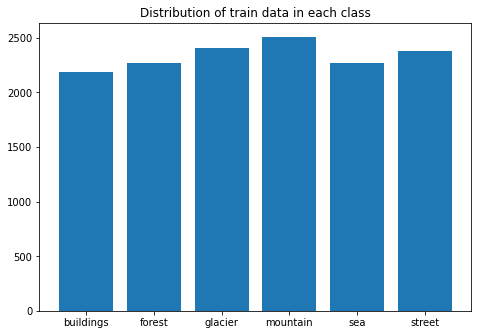

In [9]:
# Distribution of test data in each class
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
number_of_data = distribution_of_classes(train_data)
ax.bar(train_data.classes,number_of_data)
plt.title("Distribution of train data in each class")
print(distribution_of_classes(train_data))
plt.show()

[437, 474, 553, 525, 510, 501]


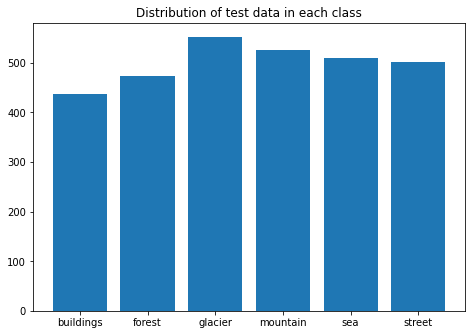

In [10]:
# Distribution of test data in each class
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
number_of_data = distribution_of_classes(test_data)
ax.bar(test_data.classes,number_of_data)
plt.title("Distribution of test data in each class")
print(distribution_of_classes(test_data))
plt.show()

###Creat train, valid and test dataloader

In [11]:
# First we pick 3000 random indices from train dataset to sample data for training 
# then we split it into two parts, for training dataset and validation dataset

indices = torch.randperm(len(train_data))[:4000]

valid_size = 0.2
sample_train = len(indices)

split = int(np.floor(valid_size * sample_train))
train_idx, valid_idx = indices[split:], indices[:split]

print(f'sample train : {len(indices)}')
print(f'train : {len(train_idx)}')
print(f'validaiton : {len(valid_idx)}')

sample train : 4000
train : 3200
validaiton : 800


In [12]:
train_sampler = torch.utils.data.Subset(train_data, train_idx) 
valid_data = torch.utils.data.Subset(train_data, valid_idx)

In [13]:
num_epoch = 2
batch_size_train = 32
batch_size_valid = 10
batch_size_test = 32
learning_rate= 0.001

In [14]:
# Create dataloader

train_loader = torch.utils.data.DataLoader(train_sampler, batch_size = batch_size_train, shuffle = True)
valid_loader = torch.utils.data.DataLoader(valid_data, batch_size = batch_size_valid, shuffle = False)
test_loader = torch.utils.data.DataLoader(test_data, batch_size = batch_size_test, shuffle = False)

print(f'length of train_dataset is : {len(train_data)} and length of sampler is : {len(train_sampler)} and length of train_loader is : {len(train_loader)}')
print(f'length of valid_dataset is : {len(valid_data)} and length of valid_loader is : {len(valid_loader)}')
print(f'length of test_dataset is : {len(test_data)} and length of test_loader is : {len(test_loader)}')

length of train_dataset is : 14034 and length of sampler is : 3200 and length of train_loader is : 100
length of valid_dataset is : 800 and length of valid_loader is : 80
length of test_dataset is : 3000 and length of test_loader is : 94


Let's take a look at one batch of trian loader.

In [15]:
example = iter(train_loader)
image, label = example.next()

print(f'eamples shape : {image.shape} ,labels shape : {label.shape}')

eamples shape : torch.Size([32, 3, 224, 224]) ,labels shape : torch.Size([32])


###Create Transfer Model

We use **resnet18** for transfer learning and freeze the default layer of resnet18 in order to not optimize them. Then we add one fully connected layer and optimize only this layer.

In [16]:
#Load a pretrained model and reset final fully connected layer.

model1 = models.resnet18(pretrained=True)

for param in model1.parameters():
    param.requires_grad = False

num_ftrs = model1.fc.in_features
# Here the size of each output sample is set to 6.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model1.fc = nn.Linear(num_ftrs, 6)


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


In [17]:
criterion = nn.CrossEntropyLoss()

# Observe that only parameters of final layer are being optimized as
# opposed to before.

optimizer = torch.optim.Adam(model1.fc.parameters(), lr = learning_rate)
scheduler = ExponentialLR(optimizer, gamma=0.7)

n_total_step = len(train_loader)

In [18]:
# Define a funciton to calculate accuracy for multi class classification model
def multi_class_acc(y_pred, y_act):

  y_pred_softmax = torch.softmax(y_pred, 1)
  _, y_pred_tag = torch.max(y_pred_softmax,1)

  correct = (y_pred_tag == y_act).float()  # Show which elements are the same with 1
  acc = correct.sum()/len(correct)
  acc = torch.round(acc * 100)

  return acc

###Train and evaluate model

####Monitoring with tensorboard

In [19]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('/content/drive/MyDrive/AI-Internship/model1_transfer_intelimage')

For adding events to tensorboard, after adding we should use : writer.close() or writer.flush(). Becasue I didn't use them, these events didn't add to my tensorboard.

In [20]:
train_loss, valid_loss = [], []
train_acc, valid_acc = [], []

for epoch in range(num_epoch):

  train_epoch_loss = 0
  train_epoch_acc = 0
  # train the model
  model1.train()

  loop = tqdm(enumerate(train_loader), total = n_total_step, leave = False)

  for i , (img, label) in loop:
    y_pred = model1(img)
    
    loss_train = criterion(y_pred, label)
    acc_train = multi_class_acc(y_pred, label)

    optimizer.zero_grad()
    loss_train.backward()
    optimizer.step()

    train_epoch_loss += loss_train.item()
    train_epoch_acc += acc_train.item()

    loop.set_description(f'Epoch : [{epoch}/{num_epoch}]')
    loop.set_postfix(loss = loss_train.item(), accuracy = acc_train.item()) 
    # validation
    with torch.no_grad():
      model1.eval()

      val_epoch_loss = 0
      val_epoch_acc = 0

      for img_val, label_val in valid_loader:

        y_pred_val = model1(img_val)
        loss_valid = criterion(y_pred_val, label_val)
        acc_valid = multi_class_acc(y_pred_val, label_val) 

        val_epoch_loss += loss_valid.item()
        val_epoch_acc += acc_valid.item()
      

    train_loss.append(train_epoch_loss/len(train_loader))
    train_acc.append(train_epoch_acc/len(train_loader))
    valid_loss.append(val_epoch_loss/len(valid_loader))
    valid_acc.append(val_epoch_acc/len(valid_loader))  

    if i%25 == 0:
      
      writer.add_scalar('training loss',train_epoch_loss/len(train_loader) , epoch * n_total_step + i)
      writer.add_scalar('training accuracy',train_epoch_acc/len(train_loader) , epoch * n_total_step + i)

  scheduler.step()  

       


In [21]:
torch.save(model1, '/content/drive/MyDrive/AI-Internship/model1_transfer_2epoch') # model1 with 2 epochs

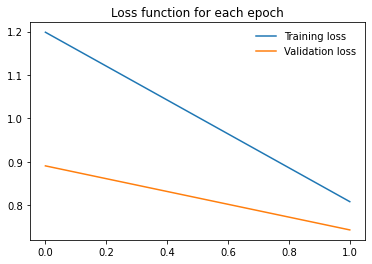

In [46]:
# loss function after each epoch
training_loss = [train_loss[99],train_loss[199]]
validation_loss = [valid_loss[99], valid_loss[199]]

#Training and validation loss
plt.plot(training_loss, label='Training loss')
plt.plot(validation_loss, label='Validation loss')
plt.legend(frameon=False)
plt.title("Loss function for each epoch") 
plt.show()

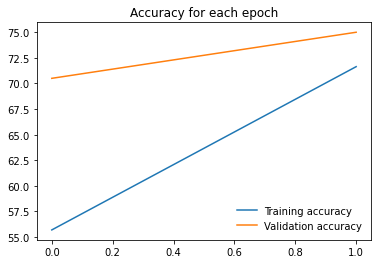

In [49]:
# accuracy after each epoch
training_acc = [train_acc[99],train_acc[199]]
validation_acc = [valid_acc[99], valid_acc[199]]

#Training and validation accuracy
plt.plot(training_acc, label='Training accuracy')
plt.plot(validation_acc, label='Validation accuracy')
plt.legend(frameon=False)
plt.title("Accuracy for each epoch")
plt.show()

In [24]:
scheduler.state_dict()

{'_get_lr_called_within_step': False,
 '_last_lr': [0.00049],
 '_step_count': 3,
 'base_lrs': [0.001],
 'gamma': 0.7,
 'last_epoch': 2,
 'verbose': False}

In [26]:
writer.flush()

In [54]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/AI-Internship/model1_transfer_intelimage'/

<IPython.core.display.Javascript object>

###Test the model

In [28]:
classes = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

In [29]:
y_pred_test = []
y_actual_test = []

model1.eval()
with torch.no_grad():
  n_true = 0
  n_total = 0
  n_class_correct = [0 for i in range(10)]
  n_class_sample = [0 for i in range(10)]
  
  for im, lbs in test_loader:

    output = model1(im)

    _, y_predtest = torch.max(output,1)

    n_true += (y_predtest == lbs).sum()
    n_total += lbs.size(0)

    for i in range(len(y_predtest)):
      y_pred_test.append(y_predtest[i])
      y_actual_test.append(lbs[i])

    for i in range(len(y_predtest)):
      lb = lbs[i]
      pred = y_predtest[i]
      if pred == lb:
        n_class_correct[lb] += 1
      n_class_sample[lb] += 1   

  print(f'accuracy of network on the 1000 images is : {(n_true/n_total) *100}')
  
  for i in range(len(classes)):
    acc = 100.0 * n_class_correct[i] / n_class_sample[i]
    print(f'Accuracy of {classes[i]}: {acc} %')

accuracy of network on the 1000 images is : 72.5999984741211
Accuracy of buildings: 73.45537757437071 %
Accuracy of forest: 88.81856540084388 %
Accuracy of glacier: 50.99457504520796 %
Accuracy of mountain: 79.80952380952381 %
Accuracy of sea: 64.50980392156863 %
Accuracy of street: 81.0379241516966 %


####Confusion matrix

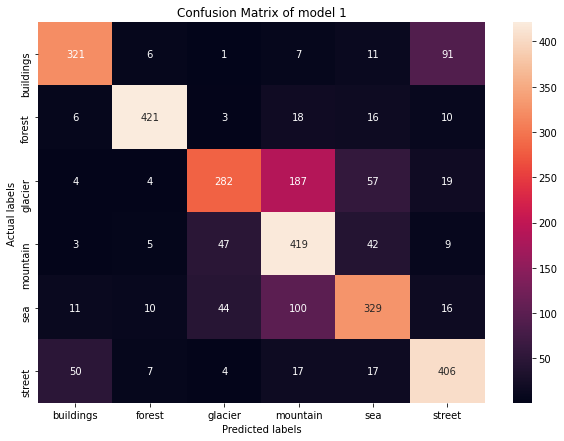

In [32]:
from sklearn import metrics
import seaborn as sns

plt.figure(figsize = (10,7))
ax= plt.subplot()
cnf_matrix = metrics.confusion_matrix(y_actual_test, y_pred_test)
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, fmt='g', ax=ax);  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('Actual labels'); 
ax.set_title('Confusion Matrix of model 1'); 
class_names=['buildings', 'forest' ,'glacier', 'mountain', 'sea' ,'street']
ax.xaxis.set_ticklabels(class_names); ax.yaxis.set_ticklabels(class_names);

####Classificaiton report

In [33]:
print(classification_report(y_actual_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.81      0.73      0.77       437
           1       0.93      0.89      0.91       474
           2       0.74      0.51      0.60       553
           3       0.56      0.80      0.66       525
           4       0.70      0.65      0.67       510
           5       0.74      0.81      0.77       501

    accuracy                           0.73      3000
   macro avg       0.75      0.73      0.73      3000
weighted avg       0.74      0.73      0.73      3000



Let's take a look at one batch of train loader and architecture of out model.


In [53]:
images, labels = next(iter(train_loader))
grid = torchvision.utils.make_grid(images)
writer.add_image("images", grid)
writer.add_graph(model1, images)
writer.close()